**Importing Packages**

In [1]:
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns

import librosa
import librosa.display

import IPython
from IPython.display import Audio,display

import warnings
warnings.filterwarnings("ignore")

from glob import glob

from itertools import cycle
sns.set_theme(style="white", palette=None)
color_pal = plt.rcParams["axes.prop_cycle"].by_key()["color"]
color_cycle = cycle(plt.rcParams["axes.prop_cycle"].by_key()["color"])

**Reading and Playing Audio Files**

In [2]:
path = glob(r"C:\Users\Sirisha\AUDIO PROCESSING TASK\NEW DATA\ VAMSI\*.wav")
Total_path = glob(r"C:\Users\Sirisha\AUDIO PROCESSING TASK\NEW DATA\*\*.wav")
print(f"The Total audio Files Present In 5 Speaker:-{len(Total_path)}")
print("-"*120)
path

The Total audio Files Present In 5 Speaker:-377
------------------------------------------------------------------------------------------------------------------------


['C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart1.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart2.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart3.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart4.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart5.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart6.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart7.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart8.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna1 Npart9.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna10 Npart1.wav',
 'C:\\Users\\Sirisha\\AUDIO PROCESSING TASK\\NEW DATA\\ VAMSI\\vamsi krishna10 Npart2.wav

In [3]:
for i in range(3):
    print(path[i])
    print(display(Audio(path[i])))

C:\Users\Sirisha\AUDIO PROCESSING TASK\NEW DATA\ VAMSI\vamsi krishna1 Npart1.wav


None
C:\Users\Sirisha\AUDIO PROCESSING TASK\NEW DATA\ VAMSI\vamsi krishna1 Npart2.wav


None
C:\Users\Sirisha\AUDIO PROCESSING TASK\NEW DATA\ VAMSI\vamsi krishna1 Npart3.wav


None


In [4]:
raw_data, sample_rate = librosa.load(path[0])
print(f"The np array :-{raw_data}")
print(f"The shape of the np array:-{raw_data.shape}")
print(f"The Sample_rate of the audio Per Second:-{sample_rate}")

The np array :-[0.0000000e+00 0.0000000e+00 0.0000000e+00 ... 4.7237196e-04 3.3907127e-04
 8.6514010e-05]
The shape of the np array:-(1323000,)
The Sample_rate of the audio Per Second:-22050


**Plotting Raw Audio In Waveform**

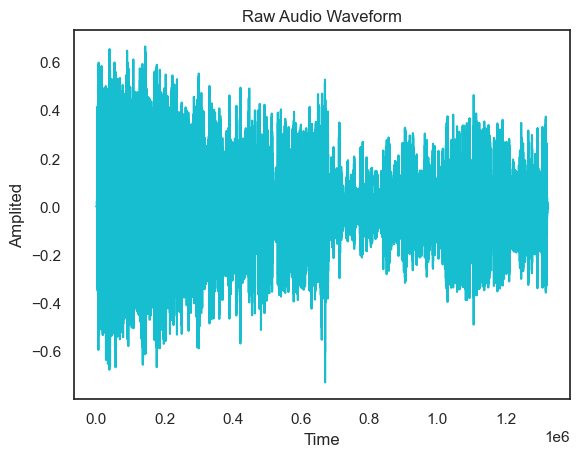

In [5]:
y = pd.Series(raw_data)
plt.title("Raw Audio Waveform")
plt.plot(y,color=color_pal[9],)
plt.ylabel("Amplited")
plt.xlabel("Time")
plt.show()


**Zooming The Audio File**

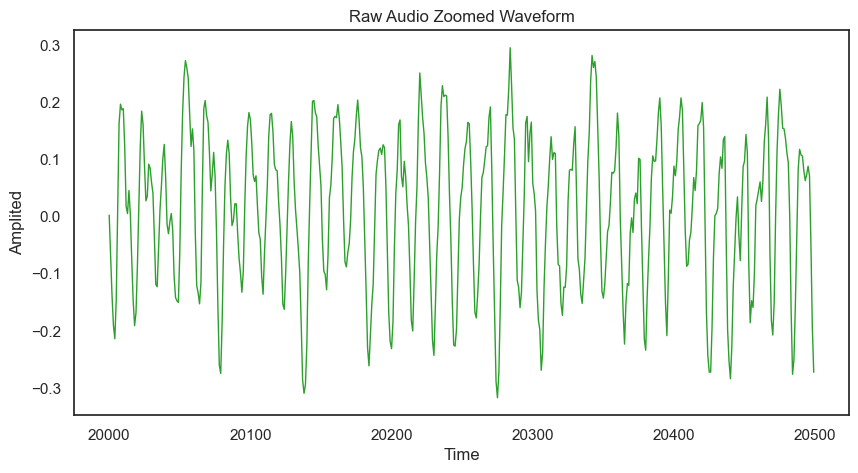

In [6]:
y[20000:20500].plot(figsize=(10,5),lw=1,color=color_pal[2])
plt.title("Raw Audio Zoomed Waveform")
plt.ylabel("Amplited")
plt.xlabel("Time")
plt.show()

**Trimmed And Zooming Audio File**

In [7]:
y_trimmed , _ = librosa.effects.trim(y,top_db=1,)
print(y.shape)
print(y_trimmed.shape)

(1323000,)
(633856,)


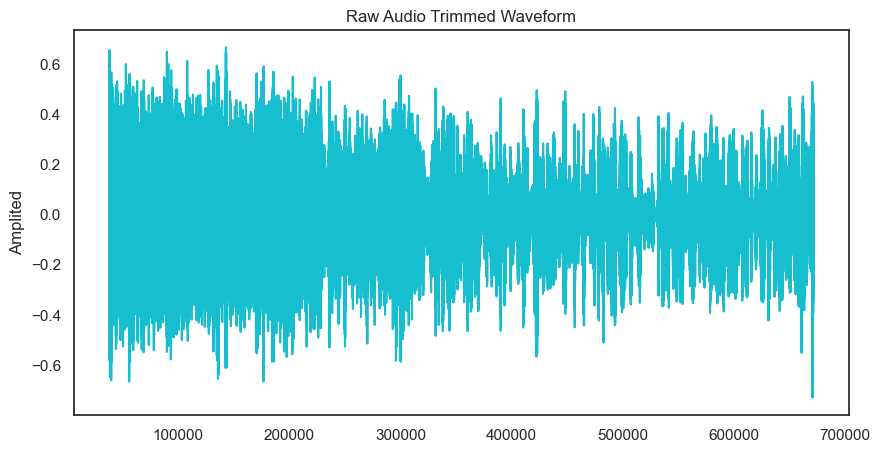

In [9]:
y_trimmed.plot(figsize=(10,5),color=color_pal[9])
plt.title("Raw Audio Trimmed Waveform")
plt.ylabel("Amplited")
plt.show()

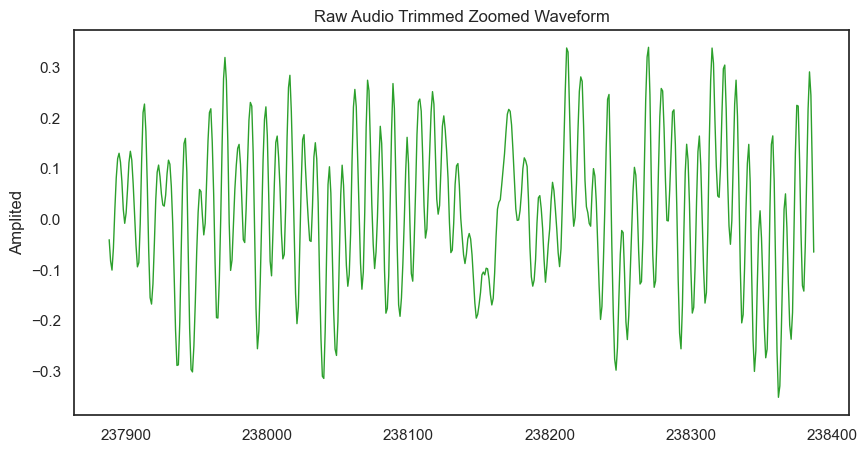

In [8]:
y_trimmed[200000:200500].plot(figsize=(10,5),lw=1,color=color_pal[2])
plt.title("Raw Audio Trimmed Zoomed Waveform")
plt.ylabel("Amplited")
plt.show()

**Fourier Transform**
- Basically that allows us to do is extract out which frequency are sounding at different parts in the audio file

**Spectogram**

In [10]:
T = librosa.stft(raw_data)
T

array([[ 1.7321013e-06+0.0000000e+00j,  3.8416764e-01+0.0000000e+00j,
         2.6712728e+00+0.0000000e+00j, ...,
         7.0558864e-01+0.0000000e+00j,  5.3286886e-01+0.0000000e+00j,
         3.3757466e-01+0.0000000e+00j],
       [-3.6846347e-06+3.1103207e-06j,  2.2368391e-01+2.9625711e-01j,
        -1.4288110e+00+1.9742808e+00j, ...,
        -3.0051631e-01-6.7344434e-03j, -3.0673343e-01-1.6327929e-01j,
        -1.5178931e-01-2.7012967e-02j],
       [-7.5074140e-06-6.2874542e-06j, -9.4341561e-02+3.2123917e-01j,
        -4.7788364e-01-1.8030198e+00j, ...,
        -2.1601646e-01-1.9050828e-01j,  6.5820463e-02+2.9939699e-01j,
         7.1555443e-02-1.5588671e-01j],
       ...,
       [-4.5181206e-10-3.4384634e-10j, -3.1141036e-09-2.4943350e-10j,
        -1.4569082e-07+2.4613843e-08j, ...,
         6.9776007e-07+6.5125905e-09j, -1.3199526e-07+3.2745720e-07j,
        -5.5146174e-06+1.8973951e-07j],
       [-3.9431791e-10+1.8513930e-11j, -5.0371947e-09+4.7729454e-10j,
        -9.5753911e-08

In [11]:
s_db = librosa.amplitude_to_db(np.abs(T), ref=np.max)
s_db

array([[-80.      , -52.39219 , -35.54824 , ..., -47.111572, -49.550198,
        -53.515205],
       [-80.      , -52.690025, -36.34526 , ..., -54.523064, -53.263893,
        -60.322365],
       [-80.      , -53.586742, -38.667744, ..., -54.8941  , -54.35267 ,
        -59.39605 ],
       ...,
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ],
       [-80.      , -80.      , -80.      , ..., -80.      , -80.      ,
        -80.      ]], dtype=float32)

In [12]:
print(T.shape,s_db.shape)

(1025, 2584) (1025, 2584)


In [13]:
print(T.max(),T.min())
print(s_db.max(),s_db.min())

(135.84076+0j) (-160.00372+0j)
0.0 -80.0


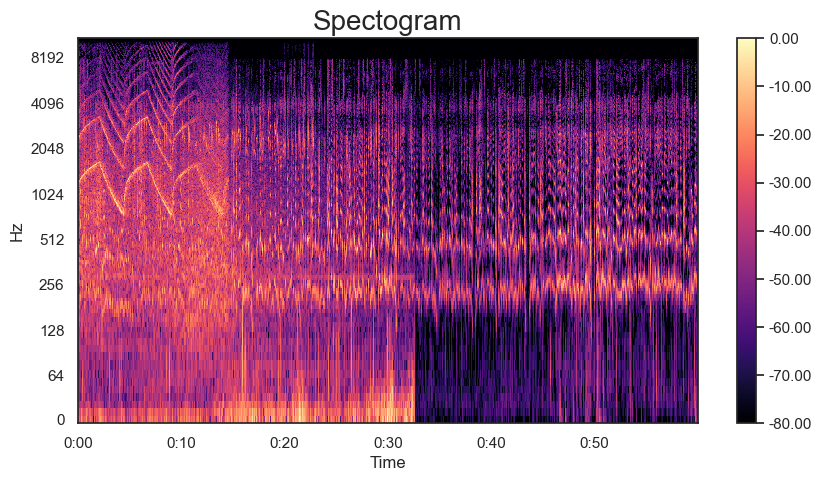

In [14]:
fig, ax = plt.subplots(figsize=(10,5))
img = librosa.display.specshow(s_db,
                              x_axis="time",
                               y_axis="log",
                               ax = ax)
ax.set_title("Spectogram", fontsize = 20)
fig.colorbar(img, ax=ax, format=f"%0.2f")
plt.show()

**Mel Spectogram**

In [15]:
S = librosa.feature.melspectrogram(y=raw_data,
                              sr=sample_rate,n_mels=1584)
S.shape

(1584, 2584)

In [16]:
s_db_mel = librosa.amplitude_to_db(S, ref=np.max)
print(s_db_mel.max(),s_db_mel.min())

7.6293945e-06 -79.99999


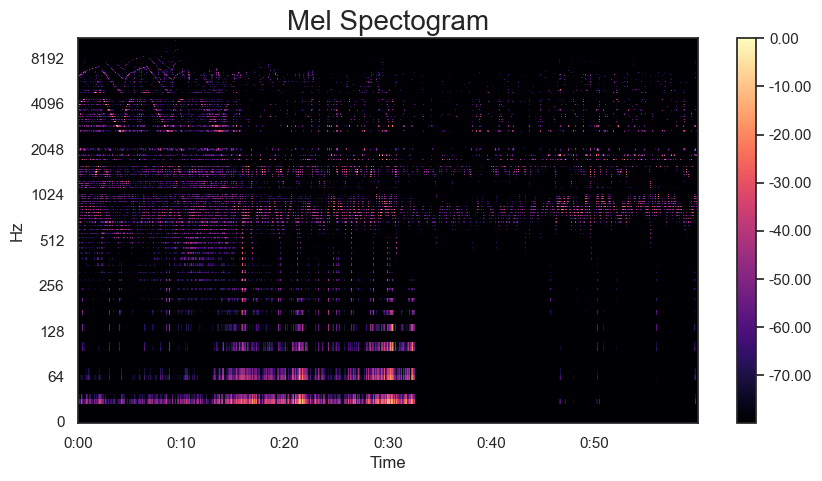

In [17]:
fig_mel, ax_mel = plt.subplots(figsize=(10,5))
img_mel = librosa.display.specshow(s_db_mel,
                              x_axis="time",
                               y_axis="log",
                               ax = ax_mel)
ax_mel.set_title("Mel Spectogram", fontsize = 20)
fig.colorbar(img_mel, ax=ax_mel, format=f"%0.2f")
plt.show()